# 🚢 포항시 교통카드 데이터 EDA

### Columns description :

| 컬럼명 (영문) |   컬럼명 (한글)  | Not Null 여부 | 데이터 타입 | 길이 |
|:-------------:|:----------------:|:-------------:|:-----------:|:----:|
|    on_date    | 승차시각         |       Y       |   datetime  |  　  |
|    off_date   | 하차시각         |       Y       |   datetime  |  　  |
|   route_name  | 노선명           |       Y       |   varchar   |  100 |
|     descr     | 노선설명         |       Y       |   varchar   |  100 |
|    age_type   | 승객연령         |       Y       |   varchar   |  20  |
|    trans_yn   | 환승여부         |       Y       |   varchar   |   1  |
|   addfee_yn   | 추가운임여부     |       Y       |   varchar   |   1  |
|  start_bstop  | 승차정류장       |       Y       |   varchar   |  100 |
|  start_gps_x  | 승차정류장 GPS X |       Y       |   numeric   | 10,7 |
|  start_gps_y  | 승차정류장 GPS Y |       Y       |   numeric   | 10,7 |
|   end_bstop   | 하차정류장       |       Y       |   varchar   |  100 |
|   end_gps_x   | 하차정류장 GPS X |       Y       |   numeric   | 10,7 |
|   end_gps_y   | 하차정류장 GPS Y |       Y       |   numeric   | 10,7 |

## 1. 라이브러리 불러오기

In [322]:
!pip install folium

In [323]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import plotly
import plotly.express as px
import folium

In [324]:
from glob import glob

data_file = glob("data/*.csv")


In [325]:
data_file[-1]

'data/data_03.csv'

## 2. 시각화를 위한 포트 설정

In [327]:
import koreanize_matplotlib

# 그래프에 retina display 적용
%config InlineBackend.figure_format = 'retina'
# 노트북 안에서 그래프를 디스플레이 하겠다. 
% matplotlib inline

UsageError: Line magic function `%` not found.


## 3. 데이터 불러오기 

In [328]:
df = pd.read_csv(data_file[-1])

In [329]:
df.head(2)

,on_date,off_date,route_name,descr,age_type,trans_yn,addfee_yn,start_bstop,start_gps_x,start_gps_y,end_bstop,end_gps_x,end_gps_y
0,20200301051547,20200301051950,160,문덕-대송-송도-죽도-용흥,일반,N,N,문덕사거리,129.403442,35.962846,성우오토모티브,129.384492,35.972675
1,20200301051756,20200301060027,500,문덕-시외터미널-흥해-청하-월포,일반,N,N,문덕사거리,129.403442,35.962846,성곡1리,129.342082,36.092129


In [330]:
# null 값 없음 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36718 entries, 0 to 36717
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   on_date      36718 non-null  int64  
 1   off_date     36718 non-null  int64  
 2   route_name   36718 non-null  object 
 3   descr        36718 non-null  object 
 4   age_type     36718 non-null  object 
 5   trans_yn     36718 non-null  object 
 6   addfee_yn    36718 non-null  object 
 7   start_bstop  36718 non-null  object 
 8   start_gps_x  36718 non-null  float64
 9   start_gps_y  36718 non-null  float64
 10  end_bstop    36718 non-null  object 
 11  end_gps_x    36718 non-null  float64
 12  end_gps_y    36718 non-null  float64
dtypes: float64(4), int64(2), object(7)
memory usage: 3.6+ MB


## 4. 파생변수 만들기
1. 탑승시간 기준 시간 column
2. 하차시간 - 탑승시간 = 대중교통 이용시간
3. 요일 데이터 나누기
4. 날짜데이터 

### 4-1. 탑승시간 기준 시간, 요일, 일, 날짜별 column 만들기

In [332]:
# 탑승시간 
df["on_date_hour"] = pd.to_datetime(df["on_date"].astype("string")).dt.hour

In [333]:
# 일 
df["on_date_day"] = pd.to_datetime(df["on_date"].astype("string")).dt.day

In [334]:
# 요일
df["on_date_dayofweek"] = pd.to_datetime(df["on_date"].astype("string")).dt.dayofweek

In [335]:
df.head(2)

,on_date,off_date,route_name,descr,age_type,trans_yn,addfee_yn,start_bstop,start_gps_x,start_gps_y,end_bstop,end_gps_x,end_gps_y,on_date_hour,on_date_day,on_date_dayofweek
0,20200301051547,20200301051950,160,문덕-대송-송도-죽도-용흥,일반,N,N,문덕사거리,129.403442,35.962846,성우오토모티브,129.384492,35.972675,5,1,6
1,20200301051756,20200301060027,500,문덕-시외터미널-흥해-청하-월포,일반,N,N,문덕사거리,129.403442,35.962846,성곡1리,129.342082,36.092129,5,1,6


In [353]:
# 요일 column 한글화 하기 
def dayofweekkorean (day_no):
    week = '월화수목금토일'
    return week[day_no]

In [354]:
df['탑승요일'] = df["탑승요일"].map(dayofweekkorean)

### 4-2. 하차시간 - 탑승시간 = 대중교통 이용시간

In [336]:
onbus = pd.to_datetime(df["on_date"].astype("string"))
offbus = pd.to_datetime(df["off_date"].astype("string"))

In [337]:
offbus - onbus

0       0 days 00:04:03
1       0 days 00:42:31
2       0 days 00:01:41
3       0 days 00:34:31
4       0 days 00:06:02
              ...      
36713   0 days 00:01:18
36714   0 days 00:09:26
36715   0 days 00:03:14
36716   0 days 00:04:07
36717   0 days 00:06:33
Length: 36718, dtype: timedelta64[ns]

In [338]:
duration = offbus - onbus
df["duration"] = round(duration.dt.total_seconds() /60,2)

In [339]:
df.head(2)

,on_date,off_date,route_name,descr,age_type,trans_yn,addfee_yn,start_bstop,start_gps_x,start_gps_y,end_bstop,end_gps_x,end_gps_y,on_date_hour,on_date_day,on_date_dayofweek,duration
0,20200301051547,20200301051950,160,문덕-대송-송도-죽도-용흥,일반,N,N,문덕사거리,129.403442,35.962846,성우오토모티브,129.384492,35.972675,5,1,6,4.05
1,20200301051756,20200301060027,500,문덕-시외터미널-흥해-청하-월포,일반,N,N,문덕사거리,129.403442,35.962846,성곡1리,129.342082,36.092129,5,1,6,42.52


### 4-3. 탑승 시간대

In [340]:
df["timerange"] = ["저녁" if x > 18 else "오후" if x >= 12  else "오전"  for x in df["on_date_hour"]]

### 4-4. 컬럼명 한글화

In [342]:
df.columns

Index(['on_date', 'off_date', 'route_name', 'descr', 'age_type', 'trans_yn',
       'addfee_yn', 'start_bstop', 'start_gps_x', 'start_gps_y', 'end_bstop',
       'end_gps_x', 'end_gps_y', 'on_date_hour', 'on_date_day',
       'on_date_dayofweek', 'duration', 'timerange'],
      dtype='object')

In [343]:
df = df.rename(columns={"on_date" : "승차시간",'off_date' : '하차시간', 'route_name' : '버스번호', 'descr':'노선', 
                   'age_type':'승객연령', 'trans_yn':'환승여부', 'addfee_yn':'추가운임여부', 'start_bstop':'승차정류장', 
                   'start_gps_x':'승차정류장 GPS X', 'start_gps_y':'승차정류장 GPS Y', 'end_bstop':'하차정류장',
                   'end_gps_x':'하차정류장 GPS X', 'end_gps_y':'하차정류장 GPS Y', 'on_date_hour':'탑승시간', 
                   'on_date_day':'탑승일','on_date_dayofweek':'탑승요일', 
                   'duration':'소요시간','timerange':'탑승시간대'})

In [396]:
df.sample(2)

,승차시간,하차시간,버스번호,노선,승객연령,환승여부,추가운임여부,승차정류장,승차정류장 GPS X,승차정류장 GPS Y,하차정류장,하차정류장 GPS X,하차정류장 GPS Y,탑승시간,탑승일,탑승요일,소요시간,탑승시간대
20061,20200304190920,20200304191427,130,양덕-장량지구-양학-시청-송도-장량지구-양덕,일반,N,N,시청,129.34117,36.018330,시외버스터미널,129.35058,36.01325,19,4,수,5.12,저녁
7395,20200302164227,20200302164739,102,문덕-남구청-고속터미널-북구보건소-양덕,일반,N,N,HCN경북방송,129.37818,36.072156,우창동주민센터,129.36193,36.05391,16,2,월,5.20,오후


## 5. 데이터 전처리

In [350]:
# 수치형 기술 통계 - 탑승시간, 소요시간
df[['탑승시간', '소요시간']].describe()

,탑승시간,소요시간
count,36718.000000,36718.000000
mean,13.034261,14.998665
std,4.361235,11.179722
min,5.000000,0.080000
25%,9.000000,7.022500
50%,13.000000,12.180000
75%,16.000000,20.020000
max,23.000000,89.850000


- 승객들의 평균 이용시간은 15분이다 <br>
- 승객들은 평균적으로 4개의 정류장을 지나쳤다

In [351]:
# 범주형 기술 통계 
df.describe(include="O")

,버스번호,노선,승객연령,환승여부,추가운임여부,승차정류장,하차정류장,탑승시간대
count,36718,36718,36718,36718,36718,36718,36718,36718
unique,56,80,4,2,2,638,551,3
top,105,양덕-시외터미널-지곡,일반,N,N,시외버스터미널,죽도시장,오후
freq,4146,4146,35051,34379,36276,1720,6136,17707


- 포항시 승객들은 105번 버스를 가장 많이 이용하였다
- 포항시 승객은 양덕-시외터미널-지곡 노선을 애용한다
- 포항시 승객들은 죽도시장 방문율이 높다
- 포항시 승객은 월요일에 대중교통을 많이 이용한다

In [352]:
# 결측치 확인하기 
df.isnull().sum()

승차시간           0
하차시간           0
버스번호           0
노선             0
승객연령           0
환승여부           0
추가운임여부         0
승차정류장          0
승차정류장 GPS X    0
승차정류장 GPS Y    0
하차정류장          0
하차정류장 GPS X    0
하차정류장 GPS Y    0
탑승시간           0
탑승일            0
탑승요일           0
소요시간           0
탑승시간대          0
dtype: int64

In [394]:
trans = df[["환승여부", "소요시간"]]
trans.groupby("환승여부").mean()

,소요시간
환승여부,
N,14.967844
Y,15.451676


- 환승여부는 소요시간과 관계가 없다

In [397]:
add = df[["추가운임여부", "소요시간"]]
add.groupby("추가운임여부").mean()

,소요시간
추가운임여부,
N,14.932966
Y,20.390701


- 추가운임이 부과되었을 때는 대중교통 소유시간이 길다.

## 6. 시각화 

### 6-1. 요일별 이용승객

In [356]:
num_per_day = df["탑승요일"].value_counts()
num_per_day = num_per_day.loc[["월","화","수","목","금","토","일"]]

In [357]:
num_per_day.mean()

5245.428571428572

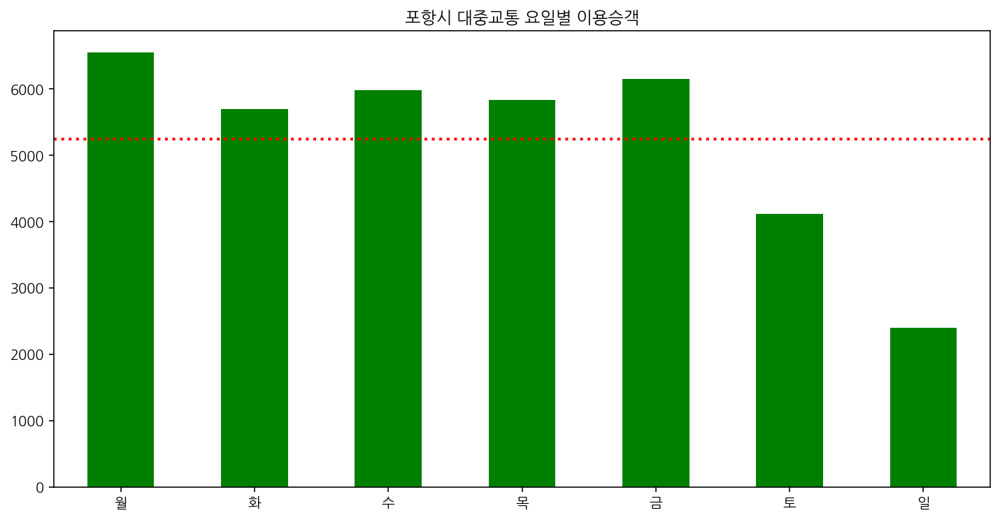

In [358]:
num_per_day.plot(kind="bar", figsize=(12,6), title="포항시 대중교통 요일별 이용승객", rot=0, color="green")
plt.axhline(num_per_day.mean(), c="red", ls=":", lw=2)

### 6-2. 요일별 이용승객 - 오전,오후,저녁으로 나누기 

In [359]:
timerange_dow = pd.crosstab(index=df["탑승시간대"], columns=df["탑승요일"])

In [360]:
timerange_dow.columns = weeklist

<AxesSubplot:title={'center':'요일-시간대별 승객수'}>

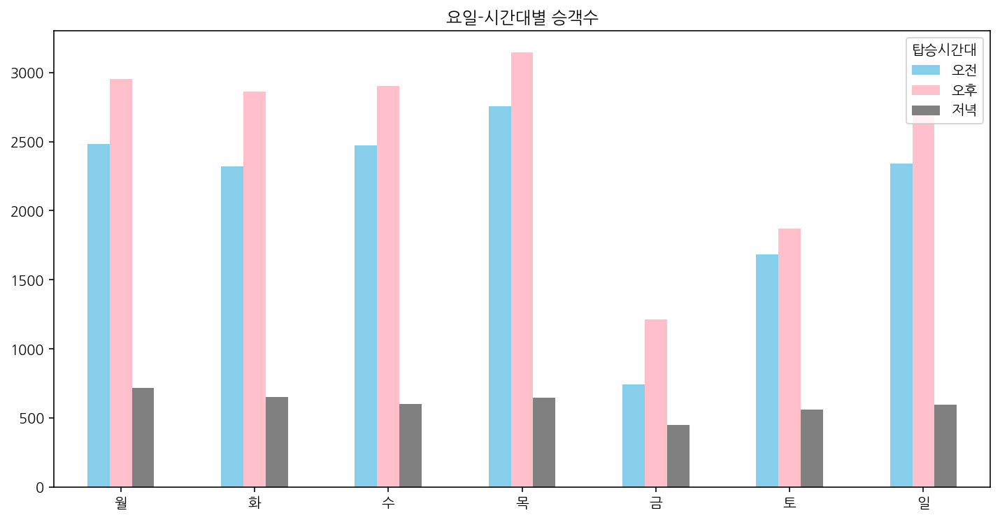

In [361]:
timerange_dow.T.plot(kind="bar",figsize=(12,6), title="요일-시간대별 승객수", rot=0, color=["skyblue", "pink", "gray"])

### 6-3. 승객 연령별 비교

In [362]:
df["승객연령"].value_counts()

일반      35051
청소년      1477
어린이       165
None       25
Name: 승객연령, dtype: int64

<AxesSubplot:>

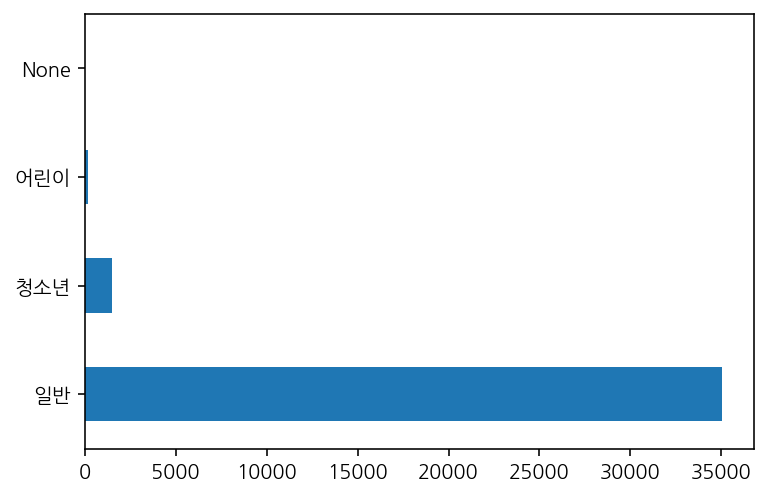

In [363]:
df["승객연령"].value_counts().plot(kind="barh")

#### 💡 none 값은 교통카드를 2번 찍었거나, 고령층 탑승 등으로 유추해 볼 수 있다

In [364]:
age_time = pd.crosstab(index=df["승객연령"], columns=df["탑승시간"])

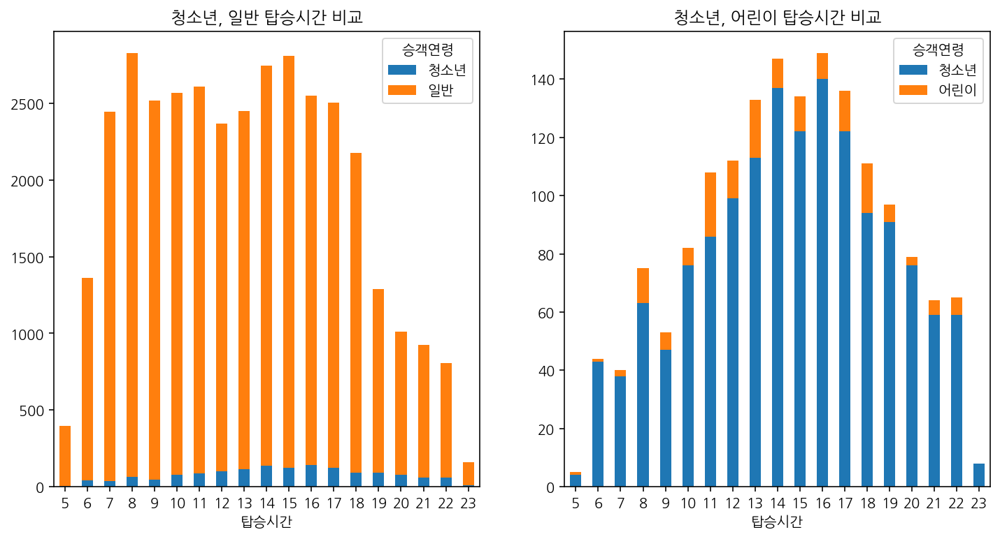

In [365]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))


age_time.T[["청소년","일반"]].plot(kind="bar", ax=ax1, stacked=True, rot=0, 
                              figsize=(12,6), title="청소년, 일반 탑승시간 비교");
age_time.T[["청소년","어린이"]].plot(kind="bar", ax=ax2 , stacked=True, rot=0, 
                                figsize=(12,6),title="청소년, 어린이 탑승시간 비교");


- 청소년과 일반 승객을 비교했을때 승객 숫자가 일반인이 압도적으로 많다
- 하지만 청소년과 어린이를 비교했을때는 청소년이 숫자가 많다 
- 청소년은 13시와 16시에 이용량이 제일 많다 

In [366]:
df_teenroute = df[df["승객연령"].isin(["어린이", "청소년"])]["노선"].value_counts()
df_teenroute.head(10)


문덕-시외(고속)터미널-흥해             217
문덕-남구청-고속터미널-북구보건소-양덕       193
양덕-고속터미널-동해                 162
문덕-고속터미널-선린병원-달전            146
양덕-시외터미널-지곡                 144
양덕-시외터미널-위덕대(유강)            117
양덕-죽도-양학-시청-유강-지곡            99
문덕-대송-송도-죽도-용흥               80
양덕-남구청(야구장)-구룡포              76
양덕-장량지구-양학-시청-송도-장량지구-양덕     71
Name: 노선, dtype: int64

<AxesSubplot:>

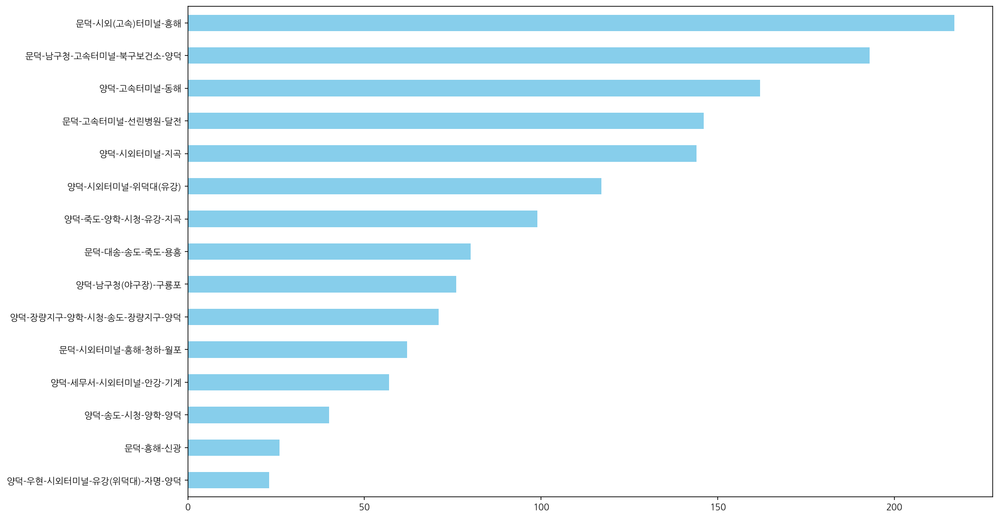

In [367]:
df_teenroute[:15].sort_values().plot(kind='barh',figsize=(16,10), color="skyblue")

- 승객수가 많은 노선 15개를 비교했을 때 청소년과 어린이 승객의 노선은 모두 양덕이나 문덕에서 시작하는 것을 볼 수 있습니다. 

In [368]:
# 승차 정류장 기준 비교
df_teenstart = df[df["승객연령"].isin(["어린이", "청소년"])]["승차정류장"].value_counts()

<AxesSubplot:>

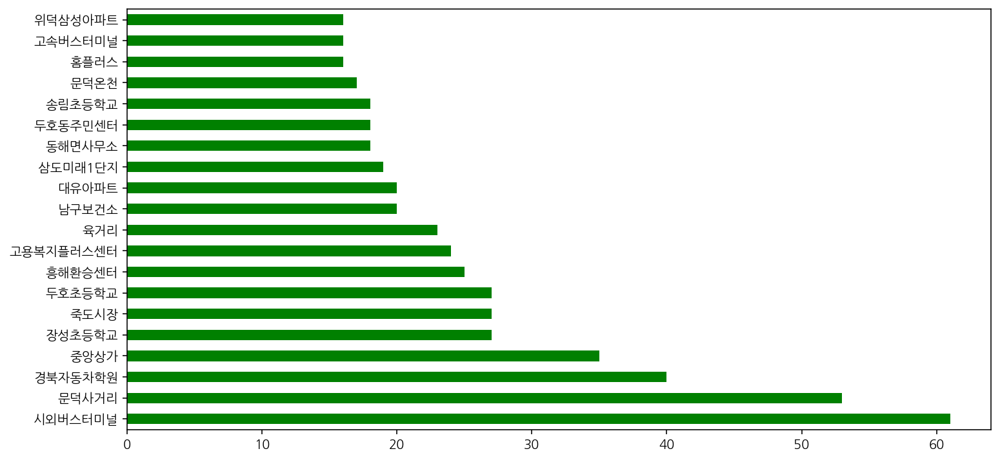

In [369]:
df_teenstart[:20].plot(kind="barh", figsize=(12,6), color="green")

- 시외버스터미널 정류장 반경 1km 근처 : 초등학교: 3개, 중학교: 2개 고등학교: 2개 
- 문덕사거리 정류장 반경 1km 근처 : 초등학교: 2개, 중학교 : 1개 
- 경북자동차학원 정류장 반경 1km 근처 : 초등학교: 1개, 중학교: 1개, 고등학교: 1개 
#### 학생들은 주로 학교통학을 위해서 버스를 이용하는 것을 유추할 수 있습니다
#### 아침에는 주로 부모님이 데려다 주는 경우가 많지만 하교 후에는 개인적으로 대중교통을 이용하는 경우가 많을거라 추정 
#### 즉, 하차보단 승차정류장이 학교 정류장에서 타는 경우가 많다고 생각


In [370]:
df_teenend = df[df["승객연령"].isin(["어린이", "청소년"])]["하차정류장"].value_counts()

<AxesSubplot:>

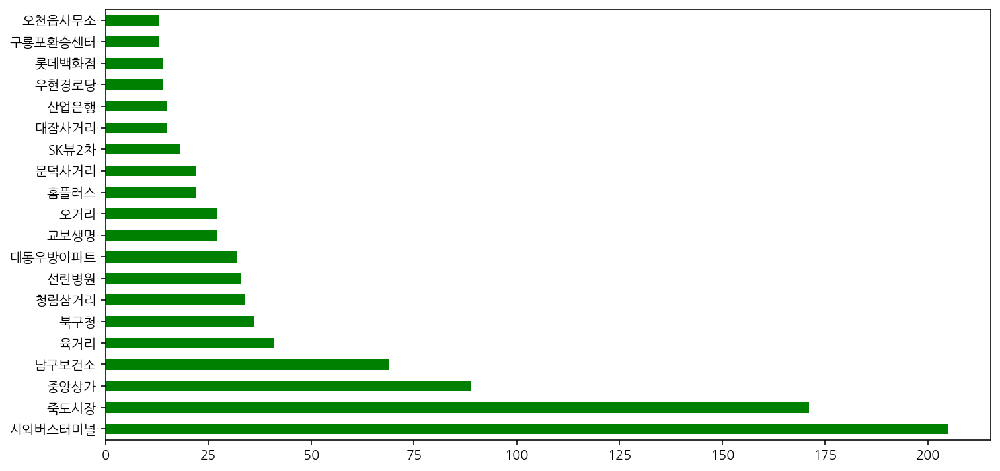

In [371]:
df_teenend[:20].plot(kind="barh", figsize=(12,6), color="green")

#### 시외버스터미널의 경우 주변 1km 반경 지역에 초중고의 수가 많아서 학생 승객이 많을거라고 유추 
#### 죽도시장과 중앙상가 정류장 근처에는 영화관이 2개와 다양한 문화시설이 많아서 하교 후 학생들이 놀러가는 장소로 이 부근을 포항 시내로 유추

### 6-4. 승객 이용이 많은 버스 노선 top 20 

In [405]:
df["버스번호"].value_counts().mean()

655.6785714285714

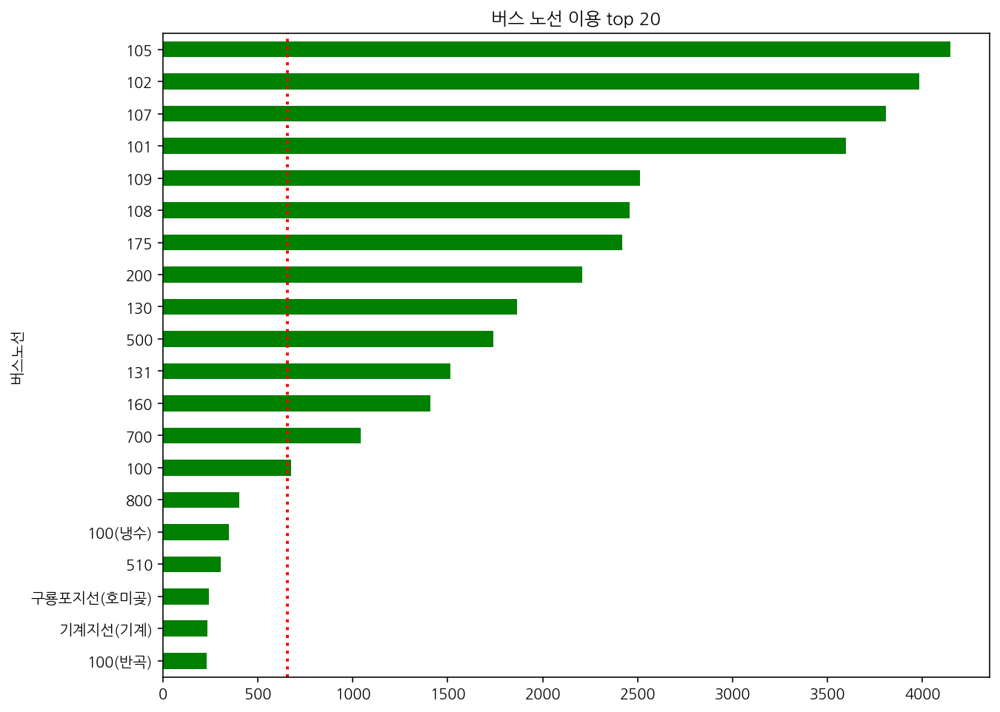

In [406]:
# 일주일 동안 승객이 이용한 노선 비율 
bus_top20 = df["버스번호"].value_counts()[:20].sort_values()
bus_top20.plot(kind="barh", figsize=(10,8), color="green", 
               title="버스 노선 이용 top 20", xlabel="버스노선")
plt.axvline(df["버스번호"].value_counts().mean(), c="red", ls=":", lw=2)

### 6-5. 요일, 시간대를 기준으로 이용승객 빈도수 구하기

In [374]:
day_time = pd.crosstab(index=df["탑승시간"], columns=df["탑승요일"])

In [414]:
day_time = day_time[["월", "화","수","목","금","토","일"]]

In [415]:
day_time.style.background_gradient(cmap="magma")

탑승요일,월,화,수,목,금,토,일
탑승시간,,,,,,,
5,61,63,63,73,72,38,26
6,214,207,254,228,220,165,81
7,474,394,415,404,408,241,113
8,558,453,478,452,473,292,137
9,465,403,416,353,455,306,128
10,489,411,435,370,416,309,145
11,493,410,412,439,439,330,112
12,434,391,376,364,373,304,141
13,464,403,407,382,371,288,155


## 6-6. 많이 내린, 많이 탄 버스정류장 top 10 subplot으로 표현하기

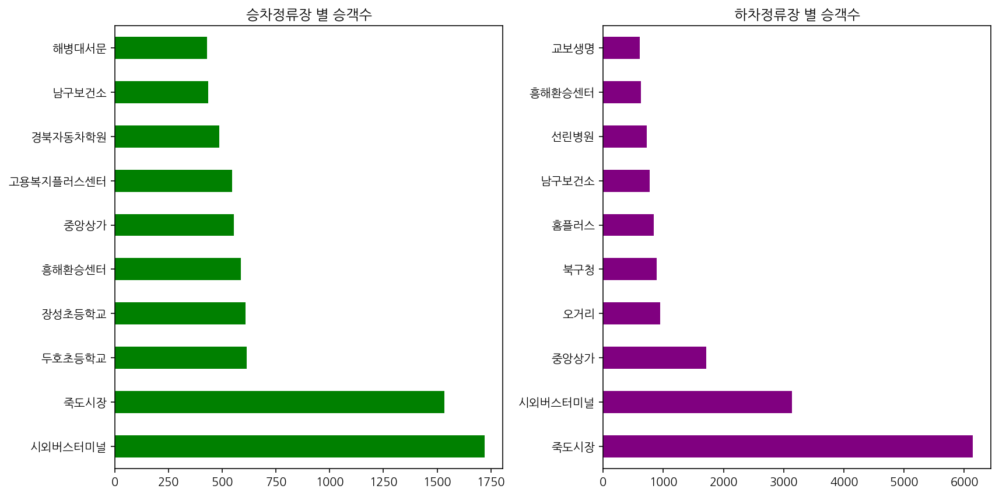

In [376]:
import matplotlib.pyplot as plt

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

df["승차정류장"].value_counts()[:10].plot(kind="barh", ax=ax1, color="green")
ax1.set_title('승차정류장 별 승객수')

df["하차정류장"].value_counts()[:10].plot(kind="barh", ax=ax2, color="purple")
ax2.set_title('하차정류장 별 승객수')

plt.tight_layout()
plt.show()

In [377]:
# pivot_table 사용해보기 
# pivott = pd.pivot_table(data=df, index="탑승요일",
#                columns="탑승시간", aggfunc="count",values="버스번호")

### 6-7. folium 이용해서 지도 시각화 하기

In [378]:
pohang_map = folium.Map(location=[36.00838325894484,129.3750422442809],
           zoom_start=13,
           width=1000,
           height=800)

In [380]:
bus_stop_start = df[["승차정류장 GPS Y","승차정류장 GPS X","승차정류장"]]
bus_stop_end = df[["하차정류장 GPS Y","하차정류장 GPS X","하차정류장"]]

In [381]:
from folium.plugins import MarkerCluster

In [382]:
marker_cluster = MarkerCluster().add_to(pohang_map)

In [383]:
for lat, long in zip(bus_stop_start["승차정류장 GPS Y"], bus_stop_start["승차정류장 GPS X"]):
    folium.Marker([lat,long], icon = folium.Icon(color="green")).add_to(marker_cluster)

In [384]:
pohang_map